In [9]:
def get_monthly_prices_for_a_token():
    import requests
    import os
    api_key = os.environ["BITQUERY"]

    url = 'https://graphql.bitquery.io/'
    query = f"""
{{
    ethereum {{
        smartContractCalls(
            options: {{desc: "block.height", limit: 25000}}, 
            smartContractMethod: {{is: "Contract Creation"}}, 
            smartContractType: {{is: Token}}) {{
            block {{
                height
                timestamp {{
                    time
                }}
            }}
            smartContract {{
                contractType
                address {{
                    address
                    annotation
                }}
                currency {{
                    name
                    symbol
                    decimals
                    tokenType
                }}
            }}
        }}
    }}
}}
"""


    # Headers including your API key
    headers = {
        'Content-Type': 'application/json',
        'X-API-KEY': api_key
    }

    # Make the POST request
    response = requests.post(url, json={'query': query}, headers=headers)

    # Check the response
    if response.status_code == 200:
        try:
            print(response.json())
        except ValueError:
            print("Failed to decode JSON from response:", response.text)
    else:
        print("Failed to retrieve data:", response.status_code, response.text)
    return response

In [10]:
x = get_monthly_prices_for_a_token()

{'data': {'ethereum': {'smartContractCalls': [{'block': {'height': 19705065, 'timestamp': {'time': '2024-04-21 16:46:35'}}, 'smartContract': {'contractType': 'Token', 'address': {'address': '0x998b7ddb1181c799a7fccb5b580d40284b84a387', 'annotation': None}, 'currency': {'name': '-', 'symbol': '-', 'decimals': 0, 'tokenType': '-'}}}, {'block': {'height': 19705038, 'timestamp': {'time': '2024-04-21 16:41:11'}}, 'smartContract': {'contractType': 'Token', 'address': {'address': '0xb608fb976edaa6d8cd7f3065fb3e7c796aa57b66', 'annotation': None}, 'currency': {'name': '-', 'symbol': '-', 'decimals': 0, 'tokenType': '-'}}}, {'block': {'height': 19705030, 'timestamp': {'time': '2024-04-21 16:39:23'}}, 'smartContract': {'contractType': 'Token', 'address': {'address': '0x0f97d402f76da81bce84ef9bdbcb4014305b0cd7', 'annotation': None}, 'currency': {'name': '-', 'symbol': '-', 'decimals': 0, 'tokenType': '-'}}}, {'block': {'height': 19705013, 'timestamp': {'time': '2024-04-21 16:35:59'}}, 'smartContra

In [13]:
x.json()

{'data': {'ethereum': {'smartContractCalls': [{'block': {'height': 19705065,
      'timestamp': {'time': '2024-04-21 16:46:35'}},
     'smartContract': {'contractType': 'Token',
      'address': {'address': '0x998b7ddb1181c799a7fccb5b580d40284b84a387',
       'annotation': None},
      'currency': {'name': '-',
       'symbol': '-',
       'decimals': 0,
       'tokenType': '-'}}},
    {'block': {'height': 19705038,
      'timestamp': {'time': '2024-04-21 16:41:11'}},
     'smartContract': {'contractType': 'Token',
      'address': {'address': '0xb608fb976edaa6d8cd7f3065fb3e7c796aa57b66',
       'annotation': None},
      'currency': {'name': '-',
       'symbol': '-',
       'decimals': 0,
       'tokenType': '-'}}},
    {'block': {'height': 19705030,
      'timestamp': {'time': '2024-04-21 16:39:23'}},
     'smartContract': {'contractType': 'Token',
      'address': {'address': '0x0f97d402f76da81bce84ef9bdbcb4014305b0cd7',
       'annotation': None},
      'currency': {'name': '-',
 

In [18]:
data = x.json()['data']['ethereum']
['smartContractCalls'][0]

{'block': {'height': 19705065, 'timestamp': {'time': '2024-04-21 16:46:35'}},
 'smartContract': {'contractType': 'Token',
  'address': {'address': '0x998b7ddb1181c799a7fccb5b580d40284b84a387',
   'annotation': None},
  'currency': {'name': '-', 'symbol': '-', 'decimals': 0, 'tokenType': '-'}}}

In [22]:
import json
import pandas as pd

# Assuming 'x' is your response object from a request
response_json = x.json()  # this is a hypothetical function call

# First, verify the structure of your JSON response
print(json.dumps(response_json, indent=2))

# Let's say the correct path in the JSON is something like this:
data = response_json['data']['ethereum']['smartContractCalls']  # adjust this path based on actual JSON structure

# Now, you can try creating the DataFrame again, using the correct path:
df = pd.DataFrame({
    'Block Height': [item['block']['height'] for item in data],
    'Timestamp': [item['block']['timestamp']['time'] for item in data],
    'Contract Type': [item['smartContract']['contractType'] for item in data],
    'Address': [item['smartContract']['address']['address'] for item in data],
    'Annotation': [item['smartContract']['address']['annotation'] if item['smartContract']['address']['annotation'] is not None else '-' for item in data],
    'Currency Name': [item['smartContract']['currency']['name'] for item in data],
    'Currency Symbol': [item['smartContract']['currency']['symbol'] for item in data],
    'Decimals': [item['smartContract']['currency']['decimals'] for item in data],
    'Token Type': [item['smartContract']['currency']['tokenType'] for item in data]
})

print(df)


{
  "data": {
    "ethereum": {
      "smartContractCalls": [
        {
          "block": {
            "height": 19705065,
            "timestamp": {
              "time": "2024-04-21 16:46:35"
            }
          },
          "smartContract": {
            "contractType": "Token",
            "address": {
              "address": "0x998b7ddb1181c799a7fccb5b580d40284b84a387",
              "annotation": null
            },
            "currency": {
              "name": "-",
              "symbol": "-",
              "decimals": 0,
              "tokenType": "-"
            }
          }
        },
        {
          "block": {
            "height": 19705038,
            "timestamp": {
              "time": "2024-04-21 16:41:11"
            }
          },
          "smartContract": {
            "contractType": "Token",
            "address": {
              "address": "0xb608fb976edaa6d8cd7f3065fb3e7c796aa57b66",
              "annotation": null
            },
            "curr

<Axes: xlabel='date'>

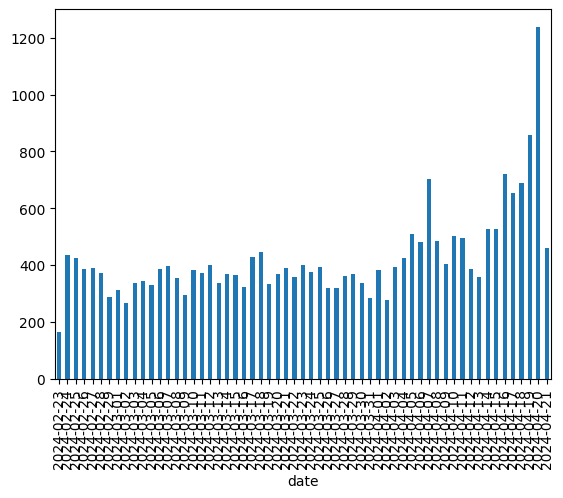

In [39]:
df['date'] = pd.to_datetime(df.Timestamp).dt.date
df.groupby('date').count().Timestamp.plot(kind='bar')
# .plot()

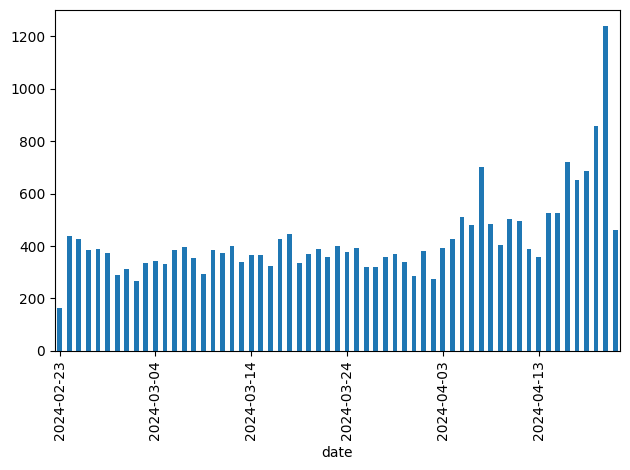

In [41]:
import matplotlib.pyplot as plt

df_grouped = df.groupby('date').count()

# Plotting
fig, ax = plt.subplots()
df_grouped['Timestamp'].plot(kind='bar', ax=ax)

# Customize x-axis to show fewer labels
ax.set_xticks(ax.get_xticks()[::10])  # Show every 10th label

plt.tight_layout()
plt.show()

In [24]:
df.to_csv('tokens part1.csv')